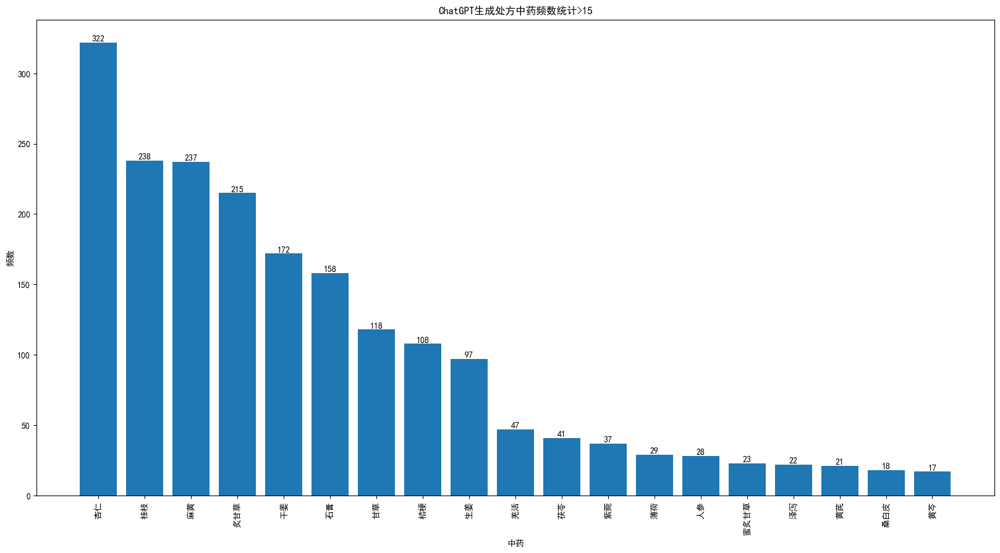

In [2]:
import pandas as pd
import numpy as np
import warnings

warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # 安装宋体显示中文
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
path = './output/chatgpt_prescription_test.txt'
herb = dict()
with open(path, 'r', encoding='utf-8') as f:
    lines = f.readlines()
    for line in lines:
      line = line.strip().replace('\n','').split(';')
      for i in line:
          if i in herb.keys():
              herb[i] += 1
          else:
              herb[i] = 1
herb = sorted(herb.items(), key=lambda x: x[1], reverse=True)
herb = pd.DataFrame(herb,columns=['herb','count'])
herb_countGT20 = herb[herb['count']>15]
plt.figure(figsize=(20, 10))
for i in herb_countGT20.index:
    plt.text(herb_countGT20['herb'][i], herb_countGT20['count'][i], herb_countGT20['count'][i], ha='center', va='bottom', fontsize=10)
plt.bar(herb_countGT20['herb'], herb_countGT20['count'])
plt.xticks(rotation=90)
plt.xlabel('中药')
plt.ylabel('频数')
plt.title('ChatGPT生成处方中药频数统计>15')
plt.savefig('./output/chatgpt_prescription_test.png', dpi=300)
plt.show()


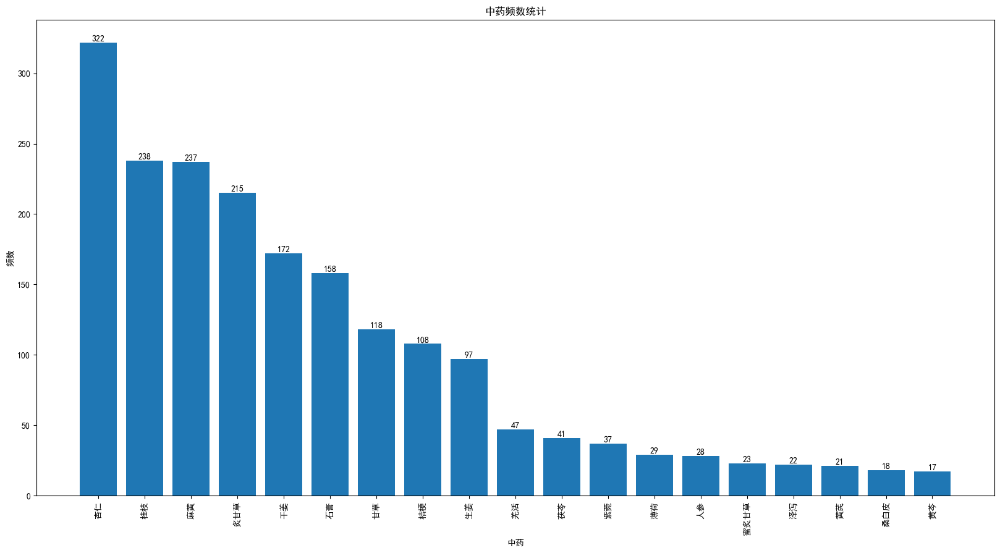

In [3]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # 安装宋体显示中文
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
path = './output/chatgpt_prescription_test.txt'
herb = dict()
with open(path, 'r', encoding='utf-8') as f:
    lines = f.readlines()
    for line in lines:
      line = line.strip().replace('\n','').split(';')
      for i in line:
          if i in herb.keys():
              herb[i] += 1
          else:
              herb[i] = 1
herb = sorted(herb.items(), key=lambda x: x[1], reverse=True)
herb = pd.DataFrame(herb,columns=['herb','count'])
herb_countGT20 = herb[herb['count']>15]
plt.figure(figsize=(20, 10))
for i in herb_countGT20.index:
    plt.text(herb_countGT20['herb'][i], herb_countGT20['count'][i], herb_countGT20['count'][i], ha='center', va='bottom', fontsize=10)
plt.bar(herb_countGT20['herb'], herb_countGT20['count'])
plt.xticks(rotation=90)
plt.xlabel('中药')
plt.ylabel('频数')
plt.title('中药频数统计')
plt.savefig('./output/chatgpt_prescription_test.png', dpi=300)
plt.show()

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # 安装宋体显示中文
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
path = './data/小儿哮喘/v1.xlsx'
data = pd.read_excel(path)
test = data[:400]
test.columns

Index(['患者编号', '性别', '出生日期', '就诊日期', '就诊状况', '病诉', '病史', '父亲健康状况', '母亲健康状况',
       '专科检查', '体格检查/望闻切诊', '辅助检查', '辩证', '治法', '中医诊断', '西医诊断', '总剂量(剂)', '药1',
       '备注', '药1剂量(g)', '药2', '备注.1', '药2剂量(g)', '药3', '备注.2', '药3剂量(g)', '药4',
       '备注.3', '药4剂量(g)', '药5', '备注.4', '药5剂量(g)', '药6', '备注.5', '药6剂量(g)',
       '药7', '备注.6', '药7剂量(g)', '药8', '备注.7', '药8剂量(g)', '药9', '备注.8',
       '药9剂量(g)', '药10', '备注.9', '药10剂量(g)', '药11', '备注.10', '药11剂量(g)', '药12',
       '备注.11', '药12剂量(g)', '药13', '备注.12', '药13剂量(g)', '药14', '备注.13',
       '药14剂量(g)', '药15', '备注.14', '药15剂量(g)', '药16', '备注.15', '药16剂量(g)',
       'Unnamed: 65', 'Unnamed: 66', 'Unnamed: 67', 'Unnamed: 68',
       'Unnamed: 69', 'Unnamed: 70', 'Unnamed: 71', 'Unnamed: 72',
       'Unnamed: 73', 'Unnamed: 74', 'Unnamed: 75', 'Unnamed: 76',
       'Unnamed: 77'],
      dtype='object')

In [5]:
herbs = test.loc[:,'药1':]
herbs.to_csv('./output/prescription_test.csv',index=False,encoding='utf-8')

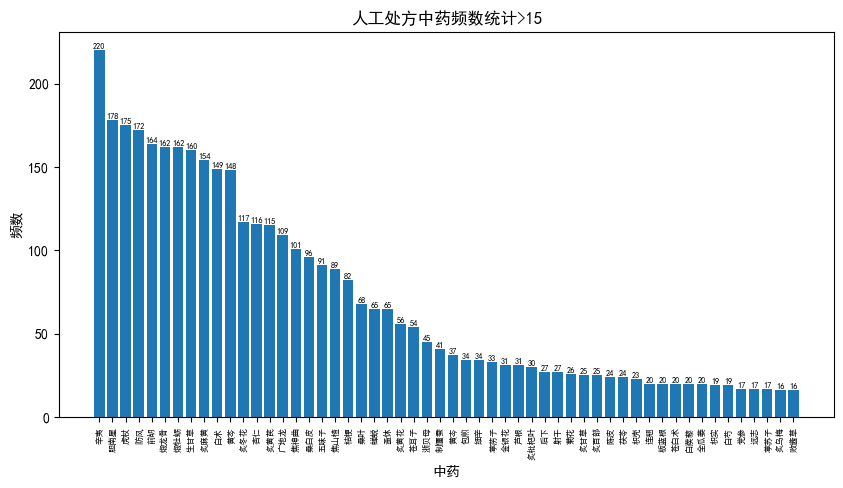

In [6]:
import pandas as pd
import numpy as np
import warnings
from collections import defaultdict

warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # 安装宋体显示中文
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
path = './output/prescription_test.txt'
herb = defaultdict(int)
with open(path, 'r', encoding='utf-8') as f:
    lines = f.readlines()
    for line in lines:
      line = line.strip().replace('\n','').split(';')
      for i in line:
          if i == '煅龙牡' or i=='煅龙牡各':
            herb['煅龙骨'] += 1
            herb['煅牡蛎'] += 1
            break
          if i in herb.keys():
              herb[i] += 1
          else:
              herb[i] = 1
del herb['各']
herb = sorted(herb.items(), key=lambda x: x[1], reverse=True)

herb = pd.DataFrame(herb,columns=['herb','count'])
herb_countGT20 = herb[herb['count']>15]

plt.figure(figsize=(10,5))
for i in herb_countGT20.index:
    plt.text(herb_countGT20['herb'][i], herb_countGT20['count'][i], herb_countGT20['count'][i], ha='center', va='bottom', fontsize=6)
plt.bar(herb_countGT20['herb'], herb_countGT20['count'])
plt.tick_params(axis='x',labelsize=6)
plt.xticks(rotation=90)
plt.xlabel('中药')
plt.ylabel('频数')
plt.title('人工处方中药频数统计>15')
plt.savefig('./output/prescription_test.png', dpi=300)
plt.show()


In [7]:
import openai
from openai.embeddings_utils import get_embeddings
response = openai.Embedding.create(input="咳嗽、呕吐、发热、纳可、寐欠安、入睡困难。",engine="text-similarity-davinci-001")
response['data'][0]['embedding']


APIConnectionError: Error communicating with OpenAI: HTTPSConnectionPool(host='api.openai.com', port=443): Max retries exceeded with url: /v1/engines/text-similarity-davinci-001/embeddings (Caused by SSLError(CertificateError("hostname 'api.openai.com' doesn't match either of '*.secure.latest.facebook.com', 'secure.latest.facebook.com'")))

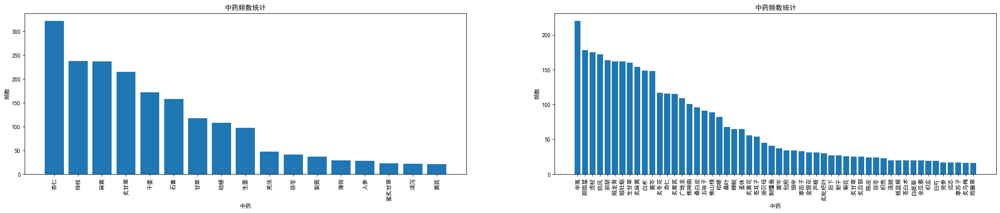

In [19]:
import pandas as pd
import numpy as np
import warnings
from collections import defaultdict
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # 安装宋体显示中文
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
path = './output/chatgpt_prescription_test.txt'
chatgpt = dict()
with open(path, 'r', encoding='utf-8') as f:
    lines = f.readlines()
    for line in lines:
      line = line.strip().replace('\n','').split(';')
      for i in line:
          if i in chatgpt.keys():
              chatgpt[i] += 1
          else:
              chatgpt[i] = 1
chatgpt = sorted(chatgpt.items(), key=lambda x: x[1], reverse=True)
chatgpt = pd.DataFrame(chatgpt,columns=['herb','count'])
chatgpt_countGT20 = chatgpt[chatgpt['count']>20]

path = './output/prescription_test.txt'
herb = defaultdict(int)
with open(path, 'r', encoding='utf-8') as f:
    lines = f.readlines()
    for line in lines:
      line = line.strip().replace('\n','').split(';')
      for i in line:
          if i == '煅龙牡' or i=='煅龙牡各':
            herb['煅龙骨'] += 1
            herb['煅牡蛎'] += 1
            break
          if i in herb.keys():
              herb[i] += 1
          else:
              herb[i] = 1
del herb['各']
herb = sorted(herb.items(), key=lambda x: x[1], reverse=True)

herb = pd.DataFrame(herb,columns=['herb','count'])
herb_countGT20 = herb[herb['count']>15]
fig,(ax1,ax2) = plt.subplots(1,2,figsize=(30,5))
ax1.bar(chatgpt_countGT20['herb'], chatgpt_countGT20['count'])
ax1.set_xticklabels(chatgpt_countGT20['herb'],rotation=90)
ax1.set_xlabel('中药')
ax1.set_ylabel('频数')
ax1.set_title('中药频数统计')
ax2.bar(herb_countGT20['herb'], herb_countGT20['count'])
ax2.set_xticklabels(herb_countGT20['herb'],rotation=90)
ax2.set_xlabel('中药')
ax2.set_ylabel('频数')
ax2.set_title('中药频数统计')
# plt.xticks(rotation=90)
plt.savefig('./output/prescription_test.png', dpi=300)
plt.show()

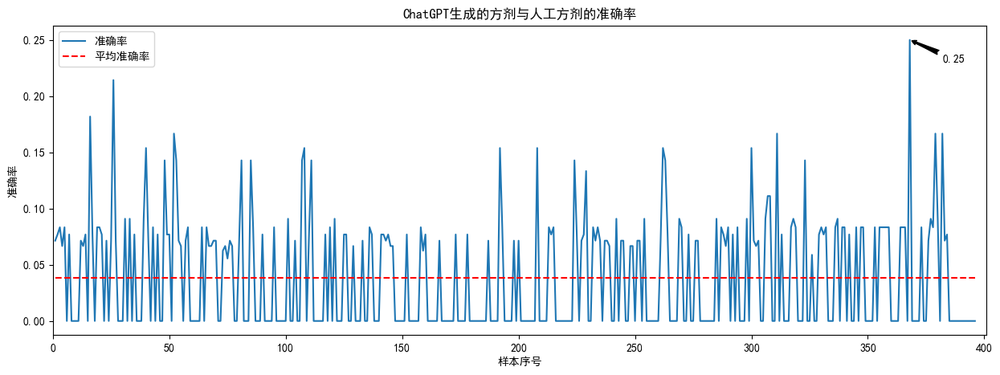

In [ ]:
p5 = np.array([])
with open('./output/chatgpt_prescription_test.txt') as f,open('./output/prescription_test.txt','r') as f1:
    chatgpt = f.readlines()
    data = f1.readlines()
    for i in range(len(chatgpt)):
        p = len(set(chatgpt[i].strip().replace(' ','').split(';'))&set(data[i].strip().replace(' ','').split(';')))/len(set(data[i].strip().replace(' ','').split(';')))
        p5 = np.append(p5,p)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # Ubuntu将宋体SimHei复制到/usr/share/fonts/目录下
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题

max_value = np.max(p5)
max_index = np.argmax(p5)
plt.figure(figsize=(15,5))
plt.plot(range(1,len(p5)+1),p5,linestyle='-')
plt.plot((1,len(p5)+1),(np.mean(p5),np.mean(p5)),color='red',linestyle='--')
plt.annotate(f'{max_value:.2f}', xy=(max_index+1, max_value), xytext=(max_index+15, max_value-0.02), arrowprops=dict(facecolor='black', arrowstyle='fancy'))
plt.xlabel('样本序号')
plt.xlim(0,len(p5)+5)
plt.ylabel('准确率')
plt.title('ChatGPT生成的方剂与人工方剂的准确率')
plt.legend(['准确率','平均准确率'],loc='upper left')
plt.savefig('./output/prescription_test_p.png', dpi=300)
plt.show()



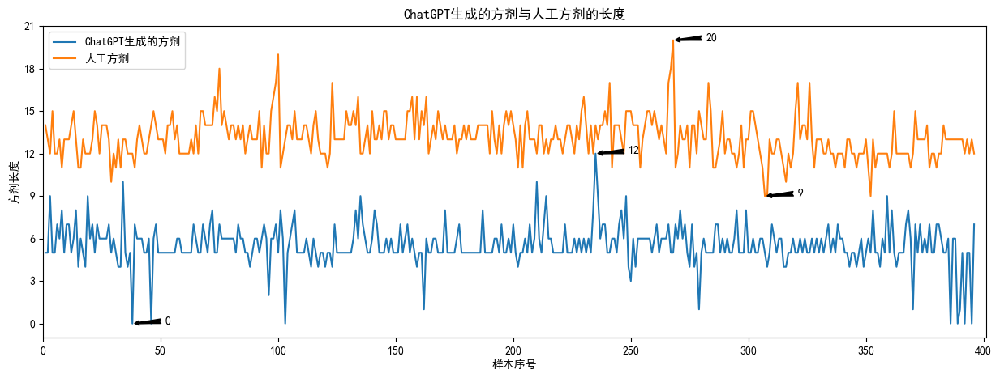

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'SimHei' # Ubuntu将宋体SimHei复制到/usr/share/fonts/目录下
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
from matplotlib.ticker import MaxNLocator
chatgpt_len = np.array([],dtype=int)
manual_len = np.array([],dtype=int)
with open('./output/chatgpt_prescription_test.txt') as f,open('./output/prescription_test.txt','r') as f1:
    chatgpt = f.readlines()
    data = f1.readlines()
    for i in range(len(chatgpt)):
        if chatgpt[i]=='\n':
            chatgpt_len = np.append(chatgpt_len,0)
        else:
            chatgpt_len = np.append(chatgpt_len,len(chatgpt[i].strip().replace(' ','').split(';')))
        manual_len = np.append(manual_len,len(data[i].strip().replace(' ','').split(';')))
chatgpt_len_is_all_integer = np.all(chatgpt_len.astype(int) == chatgpt_len)
manual_len_is_all_integer = np.all(manual_len.astype(int) == manual_len)
max_chatgpt_len = np.max(chatgpt_len)
max_chatgpt_index = np.argmax(chatgpt_len)
min_chatgpt_len = np.min(chatgpt_len)
min_chatgpt_index = np.argmin(chatgpt_len)
max_manual_len = np.max(manual_len)
max_manual_index = np.argmax(manual_len)
min_manual_len = np.min(manual_len)
min_manual_index = np.argmin(manual_len)
plt.figure(figsize=(15,5))
ax = plt.gca()
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
plt.plot(range(1,len(chatgpt_len)+1),chatgpt_len,linestyle='-')
plt.plot(range(1,len(manual_len)+1),manual_len,linestyle='-')
plt.annotate(f'{max_chatgpt_len:.0f}', xy=(max_chatgpt_index+1, max_chatgpt_len), xytext=(max_chatgpt_index+15, max_chatgpt_len-0.02), arrowprops=dict(facecolor='black', arrowstyle='fancy'))
plt.annotate(f'{max_manual_len:.0f}', xy=(max_manual_index+1, max_manual_len), xytext=(max_manual_index+15, max_manual_len-0.02), arrowprops=dict(facecolor='black', arrowstyle='fancy'))
plt.annotate(f'{min_chatgpt_len:.0f}', xy=(min_chatgpt_index+1, min_chatgpt_len), xytext=(min_chatgpt_index+15, min_chatgpt_len-0.02), arrowprops=dict(facecolor='black', arrowstyle='fancy'))
plt.annotate(f'{min_manual_len:.0f}', xy=(min_manual_index+1, min_manual_len), xytext=(min_manual_index+15, min_manual_len-0.02), arrowprops=dict(facecolor='black', arrowstyle='fancy'))
plt.xlabel('样本序号')
plt.xlim(0,len(chatgpt_len)+5)
plt.ylabel('方剂长度')
plt.title('ChatGPT生成的方剂与人工方剂的长度')
plt.legend(['ChatGPT生成的方剂','人工方剂'],loc='upper left')
plt.savefig('./output/prescription_test_len.png', dpi=300)
plt.show()

## 症状症状图

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
plt.rcParams['font.family'] = 'SimHei' # Ubuntu将宋体SimHei复制到/usr/share/fonts/目录下
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
from collections import defaultdict
sym = defaultdict(int)
with open('./output/chatgpt_symptom.txt') as f:
    symptoms = f.readlines()
    for symptom in symptoms:
        symptom = symptom.strip().replace(' ','').split('、')
        for s in symptom:
            sym[s] += 1

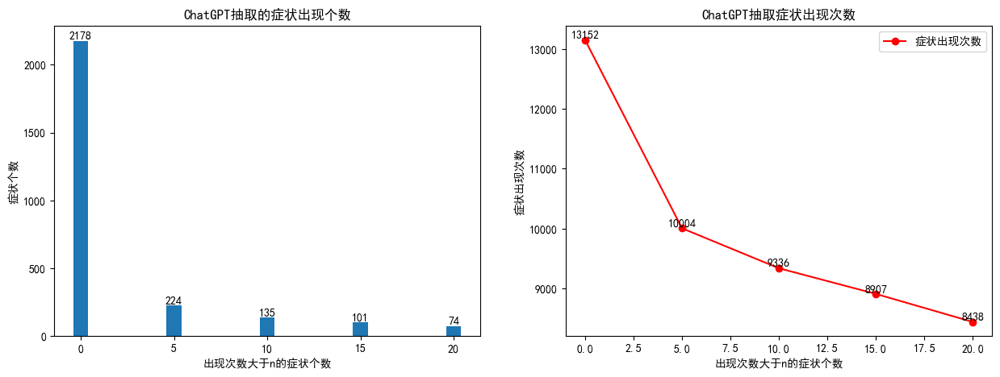

In [6]:
sym = sorted(sym.items(),key=lambda x:x[1],reverse=True)
sym = dict(sym)
symgt0 = {k: v for k, v in sym.items() if v > 0}
symgt5 = {k: v for k, v in sym.items() if v > 5}
symgt10 = {k: v for k, v in sym.items() if v > 10}
symgt15 = {k: v for k, v in sym.items() if v > 15}
symgt20 = {k: v for k, v in sym.items() if v > 20}
symlen = np.array([len(symgt0),len(symgt5),len(symgt10),len(symgt15),len(symgt20)])
synfreq = np.array([sum(symgt0.values()),sum(symgt5.values()),sum(symgt10.values()),sum(symgt15.values()),sum(symgt20.values())])
fig,(ax1,ax2) = plt.subplots(1,2,figsize=(15,5))
ax1.bar([5*i for i in range(len(symlen))],symlen)
for i in range(len(symlen)):
    ax1.text(5*i,symlen[i],symlen[i],ha='center',va='bottom')
ax1.set_xlabel('出现次数大于n的症状个数')
ax1.set_ylabel('症状个数')
ax1.set_title('ChatGPT抽取的症状出现个数')
ax2.plot([5*i for i in range(len(synfreq))],synfreq,linestyle='-',color='red',marker='o')
for i in range(len(synfreq)):
    ax2.text(5*i,synfreq[i],synfreq[i],ha='center',va='bottom')
ax2.set_ylabel('症状出现次数')
ax2.set_xlabel('出现次数大于n的症状个数')
ax2.legend(['症状出现次数'],loc='upper right')
ax2.set_title('ChatGPT抽取症状出现次数')
plt.show()

In [7]:
sym2pd = pd.DataFrame(columns=list(symgt5.keys()))
for i in tqdm(range(len(symptoms))):
    for j in symgt5.keys():
        if j in symptoms[i]:
            sym2pd.loc[i,j] = 1
        else:
            sym2pd.loc[i,j] = 0
sym2pd = sym2pd.fillna(0)
sym2pd.to_csv('./output/sym2pd.csv',index=False)
sym2pd.shape

(2106, 224)

In [8]:
import pickle
pickle.dump(symgt0,open('./output/symgt0.pkl','wb'))
pickle.dump(symgt5,open('./output/symgt5.pkl','wb'))

## 构造草药草药图


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm import tqdm
warnings.filterwarnings('ignore')
plt.rcParams['font.family'] = 'SimHei' # 安装宋体显示中文
plt.rcParams['axes.unicode_minus'] = False # 解决保存图像是负号'-'显示为方块的问题
path = './data/小儿哮喘/v1.xlsx'
data = pd.read_excel(path)
herbs = data.loc[:,'药1':]
replace_dict = {
    '地肤子（包）':'地肤子',
    '（1）炙黄芪':'炙黄芪',
    '葶苈子（包）':'葶苈子',
    '葶苈子（包)':'葶苈子',
    '黛蛤散（包）':'黛蛤散',
    '（1）炙黄芪':'炙黄芪',
    '1.桑白皮':'桑白皮',
    '2.黄岑油膏':'桑白皮',
    '（2）皮炎宁':'皮炎宁',
    '哮喘贴敷*60':'哮喘贴敷',
    '“皮炎灵”':'皮炎灵',
    '前胡5':'前胡',
    '（1）桑叶':'桑叶',
    '（2）炙黄芪':'炙黄芪',
    '氨茶碱0.1*30#':'氨茶碱',
    '扼子':'栀子',
    '百郭':'百部',
    '黄岑油膏':'黄芩油膏',
    '黄岑':'黄芩',

}
herbs.replace(replace_dict,inplace=True)
herb = herbs.values.flatten()
def is_chinese(string):
    for char in string:
        if '\u4e00' <= char <= '\u9fa5':
            continue
        else:
            return False
    return True
herbset  = set()
for i in range(len(herb)):
    if is_chinese(str(herb[i]).strip()):
        if str(herb[i]).strip().startswith('炙') or str(herb[i]).strip().startswith('炒') or str(herb[i]).strip().startswith('生'):
            herbset.add(str(herb[i]).strip()[1:])
        else:
            herbset.add(str(herb[i]).strip())
    elif str(herb[i]).strip() == 'nan':
        continue
    elif str(herb[i]).strip().isdigit():
        continue
    else:
        # print(herb[i])
        continue
remove_list = ['血查肺炎支原体抗体',
               '雾吸必要时',
               '血查肺胃功能',
               '血查肺炎支原体',
               '熬糖浆服',
               '代诉',
               '熬糖浆',
               '各',
               '过敏原测试',
               '后',
               '先下',
               '包',
               '共煎',
               '包煎',
               '先煎',
               '一瓶',
               '一盒',
               '后下',
               '外涂',
               '外用',
               '外用自备',
               '白',
               '一日三次',
               '地',
               '',
               '一瓶外用',
               '一支',
               '一条',
               '住院治疗',
               '外洗用',
               '必要时查肺炎支原体抗体',
               '散剂继服',
               '无',
               '无法识别',
               '无药',
               '血查肺支原体抗体',
               '自备',
               '备注',
               '泡下',
               '混匀'
               ]
herbset = herbset - set(remove_list)
print(f'方剂中药物种类：{len(herbset)}')
print(f'方剂中药物种类：{herbset}')

方剂中药物种类：511
方剂中药物种类：{'代赭石', '桑葚', '觅食', '海风藤', '山药', '苍术', '远吉', '枸杞子', '煅龙牡各', '吾梢', '金瓜萎', '白头荔', '头颅', '锡类散', '稀益草', '珍珠母', '调脾合剂', '淡豆封', '扁豆', '独活', '煅乌贼骨', '大葱', '龟板胶', '法半夏', '藁本', '大青叶', '矾郁金', '竹茹', '川参', '皮炎灵', '葶苈子', '紫菀', '仙灵脾', '干姜', '连翘', '矾石隐', '紫草', '老鹤草', '仙鹤草', '洋兰', '茅芦根', '刺猬皮', '全瓜蒌', '南沙参', '胆南星', '煅龟板', '肉苁蓉', '瓜萎', '麻黄', '忍冬藤', '猪耳草', '珍珠母先煎', '茅根芦根', '哮喘贴敷', '鹿衔草', '枯蝴蝶', '延胡索', '僧衣', '野菊花', '哮喘敷贴', '土河参', '刺五加', '钩藤', '瓜蒌仁', '甘草', '锦灯笼', '鸭拓草', '豨益草', '苏木', '紫苑', '天花林', '蒲公英', '茅根', '皮炎宁', '苍耳', '橘仁', '继服', '防风', '摈榔', '金蝉', '止汗灵颗粒', '制附片', '黄苓', '辛夷', '鹿角霜', '青敷', '麻仁丸', '党参', '矿红', '五灵脂', '酸枣仁', '砂仁', '芎藭', '大蝴蝶', '砥石', '鸡金', '射干', '扙黄花', '平哮合剂', '浙贝母', '山萸肉', '覆盆子', '苍白术各', '天芎竺', '雷公藤多苷片', '全狗脊', '煨益智仁', '百合部各', '白芍', '大蜈蚣', '怀牛膝', '氨茶碱', '石菖蒲', '鹿角胶', '牛蒡子', '黄精', '西芎', '桑枝', '瓜蒌皮', '老鹳草', '蚤休', '黄药子', '巴戟天', '泽兰', '灯巷红', '黄芪', '黄岑', '槐花炭', '郁李仁', '赤白芍', '速议休息一周', '川穹', '补骨脂', '水牛角片', '枳实', '翠莲草', '天葶苈子', '白前胡', '川芎', '白头翁', '川楝', '黛蛤粉', '黛蛤散', '苏子', '墨旱莲

In [2]:
herb2df = pd.DataFrame(columns=list(herbset))
for i in tqdm(range(len(herbs)),desc='正在处理方剂药物'):
    for j in herbset:
        if j in str(herbs.loc[i,:].replace(np.nan,'').values):
            herb2df.loc[i,j] = 1
        else:
            herb2df.loc[i,j] = 0

正在处理方剂药物: 100%|██████████| 2152/2152 [10:01<00:00,  3.58it/s]


In [9]:
herb2df.to_csv('./output/herb2df.csv',index=False)

In [10]:
herb2df = pd.read_csv('./output/herb2df.csv')
herb2dfgt10 = herb2df.loc[:,herb2df.sum(axis=0)>10]
herb2dfgt10.to_csv('./output/herb2dfgt10.csv',index=False)
herb2dfgt10.shape

(2152, 208)

## 草药-症状图

In [11]:
SH = pd.concat([sym2pd,herb2dfgt10],axis=1)
SH.to_csv('./output/SH.csv',index=False)
SH.shape

(2152, 432)

In [1]:
import openai
embedding =  openai.Embedding.create(input = ['a','b'], model = 'text-embedding-ada-002')['data']
len(embedding[0]['embedding'])

1536

In [27]:
import redis
pool = redis.ConnectionPool(host='localhost', port=6379, db=0,password='njucm')
r = redis.Redis(connection_pool=pool)
r.delete('embedding')

0

In [5]:
import pickle
data = pickle.load(open('data/new/embeddingswotext.pkl','rb'))


[[-0.028378337621688843,
  -0.01993371732532978,
  0.012246767990291119,
  -0.025774694979190826,
  -0.022826652973890305,
  -0.008375742472708225,
  -0.012239880859851837,
  -0.02244092896580696,
  -0.012529173865914345,
  -0.021476617082953453,
  0.012735812924802303,
  0.01950666308403015,
  0.014230497181415558,
  -0.0029273771215230227,
  -0.022385824471712112,
  -0.009539805352687836,
  0.024107811972498894,
  0.009188520722091198,
  0.04493696242570877,
  -0.02102201245725155,
  -0.0018545795464888215,
  0.0038262540474534035,
  0.007445869967341423,
  -0.008355079218745232,
  -0.01014594454318285,
  0.001809807843528688,
  0.008272423408925533,
  -0.00028068380197510123,
  -0.002801672089844942,
  -0.00225408049300313,
  0.031216172501444817,
  -0.014072074554860592,
  -0.022096531465649605,
  -0.01589738018810749,
  0.0008282755152322352,
  -0.018817869946360588,
  -0.010194160044193268,
  -0.0140238581225276,
  0.012570502236485481,
  -0.014161617495119572,
  0.00774205150082

In [10]:
import torch

# 创建两个张量
tensor1 = torch.tensor([1, 2, 3])
tensor2 = torch.tensor([4, 5, 6])

# 使用 torch.mul 进行对应元素相乘
result = torch.mul(tensor1, tensor2)
print(result)  # 输出: tensor([ 4, 10, 18])

# 或者直接使用 * 运算符进行对应元素相乘
result = tensor1 * tensor2
print(result)  # 输出: tensor([ 4, 10, 18])


tensor([ 4, 10, 18])
tensor([ 4, 10, 18])


In [14]:
import pickle
import numpy as np
chat_symptoms = np.array(pickle.load(
    open('data/new/embeddingswotext.pkl', 'rb')))
chat_symptoms.shape

(33765, 1536)